<a href="https://colab.research.google.com/github/finduglobe/Lecture-Studies/blob/master/mv_spacedebrisdetection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install -U aicrowd-cli

# Installing TOrch
!pip install pyyaml
!pip install torch torchvision
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version

  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
2.2.1+cu121 True
gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
Copyright (C) 2021 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [2]:
!python -m pip install pyyaml
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

Cloning into 'detectron2'...
remote: Enumerating objects: 15676, done.
remote: Counting objects: 100% (399/399), done.
remote: Compressing objects: 100% (304/304), done.
remote: Total 15676 (delta 177), reused 274 (delta 95), pack-reused 15277
Receiving objects: 100% (15676/15676), 6.51 MiB | 11.98 MiB/s, done.
Resolving deltas: 100% (11292/11292), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 17.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 15.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 15.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 97.9/97.9 kB 12.4 MB/s eta 0:00:00
  Created wheel for fvcore: filename=fvcore-0.1.5.post20221221-py3-none-any

In [3]:
API_KEY = "9e693da5259524ff0c3648eb69686d11"
!aicrowd login --api-key $API_KEY

API Key valid
Gitlab oauth token invalid or absent.
It is highly recommended to simply run `aicrowd login` without passing the API Key.
Saved details successfully!


In [4]:
!aicrowd dataset download --challenge debris-detection

sample_submission.csv: 100% 1.98M/1.98M [00:01<00:00, 1.69MB/s]
test.zip: 100% 259M/259M [00:39<00:00, 6.53MB/s]
train.csv: 100% 1.78M/1.78M [00:01<00:00, 1.41MB/s]
train.zip: 100% 1.04G/1.04G [02:21<00:00, 7.31MB/s]
val.csv: 100% 176k/176k [00:00<00:00, 280kB/s]
val.zip: 100% 104M/104M [00:18<00:00, 5.66MB/s]


In [5]:
!rm -rf data
!mkdir data

!unzip train.zip -d data/train > /dev/null

!unzip val.zip -d data/val > /dev/null

!unzip test.zip -d data/test > /dev/null

!mv train.csv data/train.csv
!mv val.csv data/val.csv

In [6]:
#for i in range(10):
#    !echo {i} > /content/{i}.txt
#
#!zip test /content/*.txt
#
#from google.colab import drive
#drive.mount('/content/drive')
#
#!mkdir -p "/content/drive/MyDrive/zip test"
#!cp /content/test.zip "/content/drive/MyDrive/zip test"
#
# After running this, I see the files appear in the Drive UI.
#!unzip "/content/drive/MyDrive/zip test/test.zip" -d "/content/drive/MyDrive/zip test"

  adding: content/0.txt (stored 0%)
  adding: content/1.txt (stored 0%)
  adding: content/2.txt (stored 0%)
  adding: content/3.txt (stored 0%)
  adding: content/4.txt (stored 0%)
  adding: content/5.txt (stored 0%)
  adding: content/6.txt (stored 0%)
  adding: content/7.txt (stored 0%)
  adding: content/8.txt (stored 0%)
  adding: content/9.txt (stored 0%)
Mounted at /content/drive
Archive:  /content/drive/MyDrive/zip test/test.zip
  inflating: /content/drive/MyDrive/zip test/0.jpg  
  inflating: /content/drive/MyDrive/zip test/1.jpg  
  inflating: /content/drive/MyDrive/zip test/10.jpg  
  inflating: /content/drive/MyDrive/zip test/100.jpg  
  inflating: /content/drive/MyDrive/zip test/1000.jpg  
  inflating: /content/drive/MyDrive/zip test/1001.jpg  
  inflating: /content/drive/MyDrive/zip test/1002.jpg  
  inflating: /content/drive/MyDrive/zip test/1003.jpg  
  inflating: /content/drive/MyDrive/zip test/1004.jpg  
  inflating: /content/drive/MyDrive/zip test/1005.jpg  
  inflating:

In [7]:
#for i in range(10):
#    !echo {i} > /content/{i}.txt
#
#!zip train /content/*.txt
#
#from google.colab import drive
#drive.mount('/content/drive')
#
#!mkdir -p "/content/drive/MyDrive/zip train"
#!cp /content/train.zip "/content/drive/MyDrive/zip train"
#
# After running this, I see the files appear in the Drive UI.
#!unzip "/content/drive/MyDrive/zip train/train.zip" -d "/content/drive/MyDrive/zip train"



zip error: Interrupted (aborting)
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Archive:  /content/drive/MyDrive/zip train/train.zip
  inflating: /content/drive/MyDrive/zip train/0.jpg  
  inflating: /content/drive/MyDrive/zip train/1.jpg  
  inflating: /content/drive/MyDrive/zip train/10.jpg  
  inflating: /content/drive/MyDrive/zip train/100.jpg  
  inflating: /content/drive/MyDrive/zip train/1000.jpg  
  inflating: /content/drive/MyDrive/zip train/10000.jpg  
  inflating: /content/drive/MyDrive/zip train/10001.jpg  
  inflating: /content/drive/MyDrive/zip train/10002.jpg  

In [8]:
import torch, torchvision
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

from detectron2 import model_zoo
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.structures import BoxMode

import pandas as pd
import numpy as np
import os
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import cv2
import random
from ast import literal_eval

In [9]:
data_path = "data"

train_df = pd.read_csv(os.path.join(data_path, "train.csv"))
val_df = pd.read_csv(os.path.join(data_path, "val.csv"))

In [10]:
train_df

,ImageID,bboxes
0,0,"[[282, 308, 58, 86], [228, 256, 191, 218], [10..."
1,1,"[[97, 127, 297, 332], [315, 352, 136, 168], [7..."
2,2,"[[45, 76, 244, 269], [154, 182, 457, 484], [20..."
3,3,"[[252, 282, 86, 110], [315, 333, 379, 412], [2..."
4,4,"[[175, 203, 406, 440], [57, 86, 433, 464], [26..."
...,...,...
19995,19995,"[[226, 247, 396, 424], [301, 323, 454, 479], [..."
19996,19996,"[[228, 256, 149, 177], [42, 71, 294, 331], [28..."
19997,19997,"[[443, 474, 153, 181], [138, 166, 193, 219], [..."
19998,19998,"[[34, 70, 178, 217], [400, 443, 127, 161], [43..."


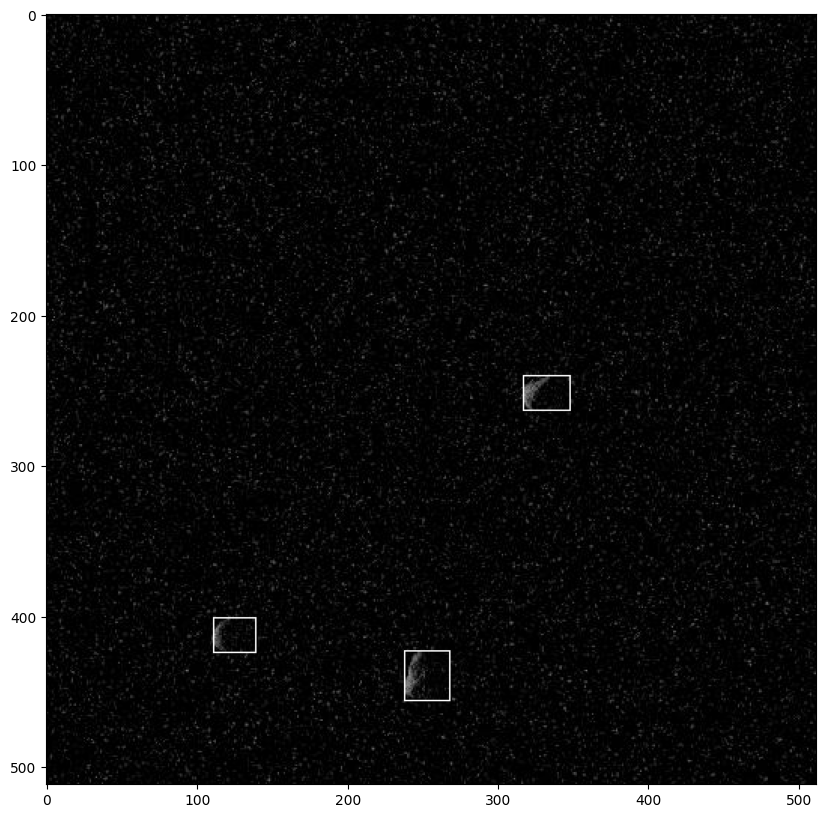

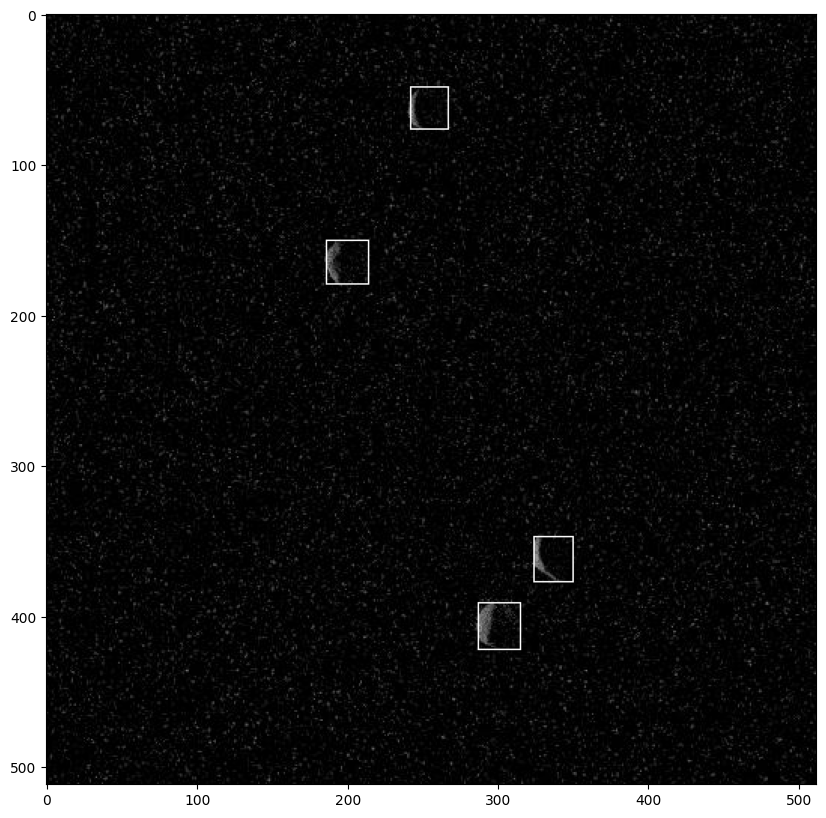

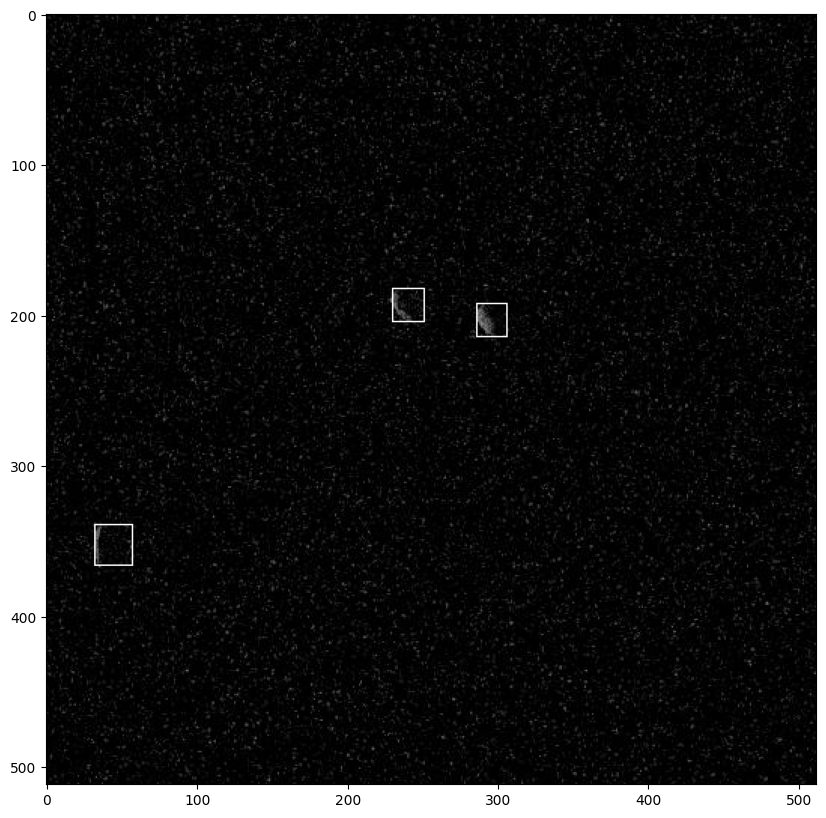

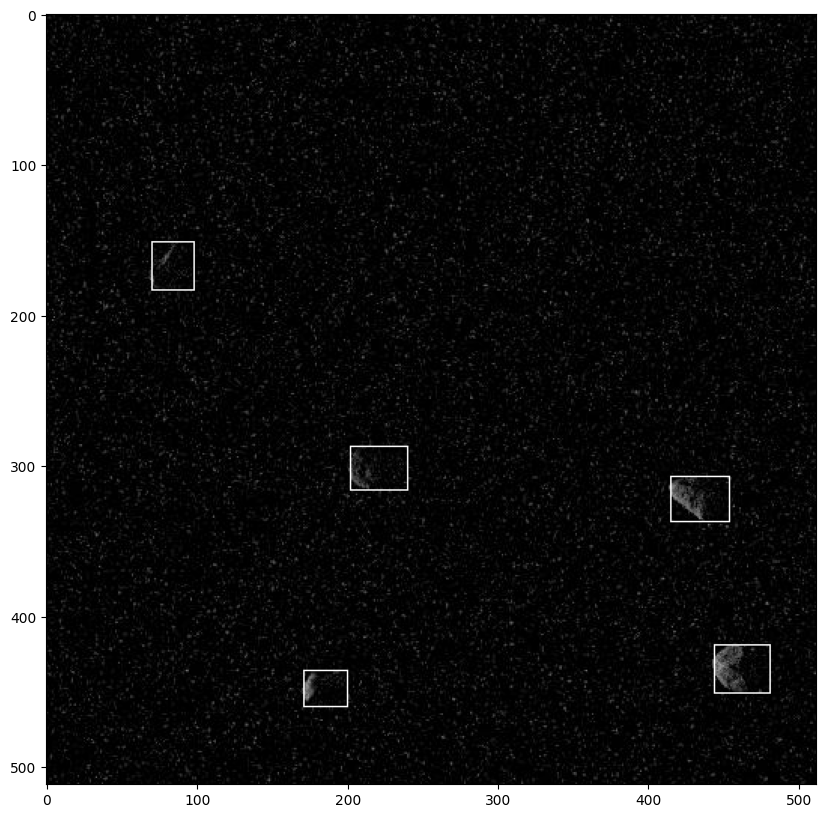

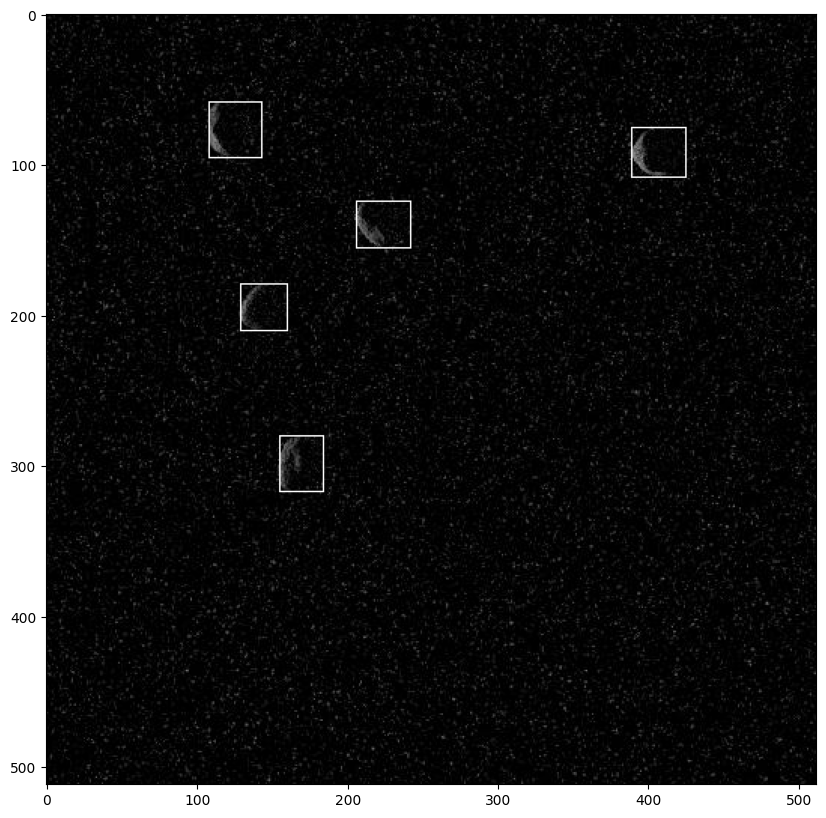

...

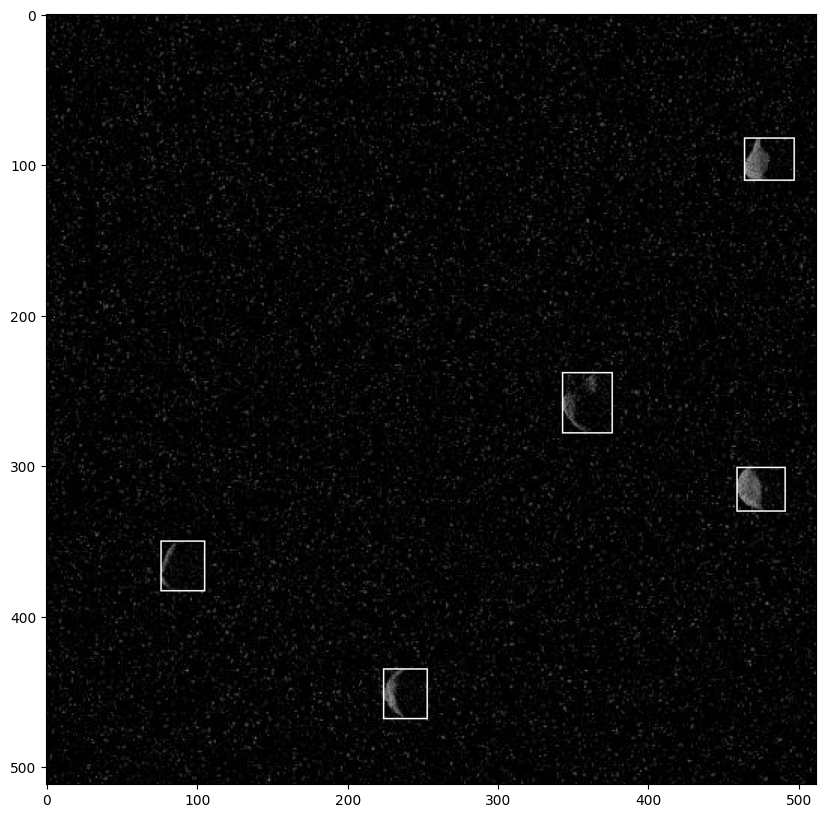

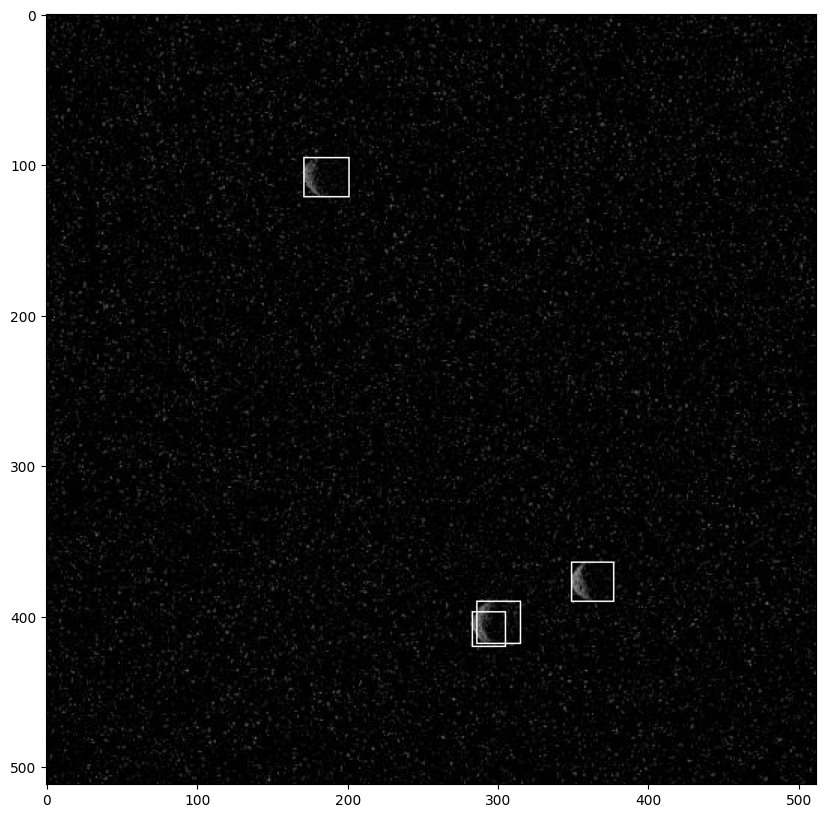

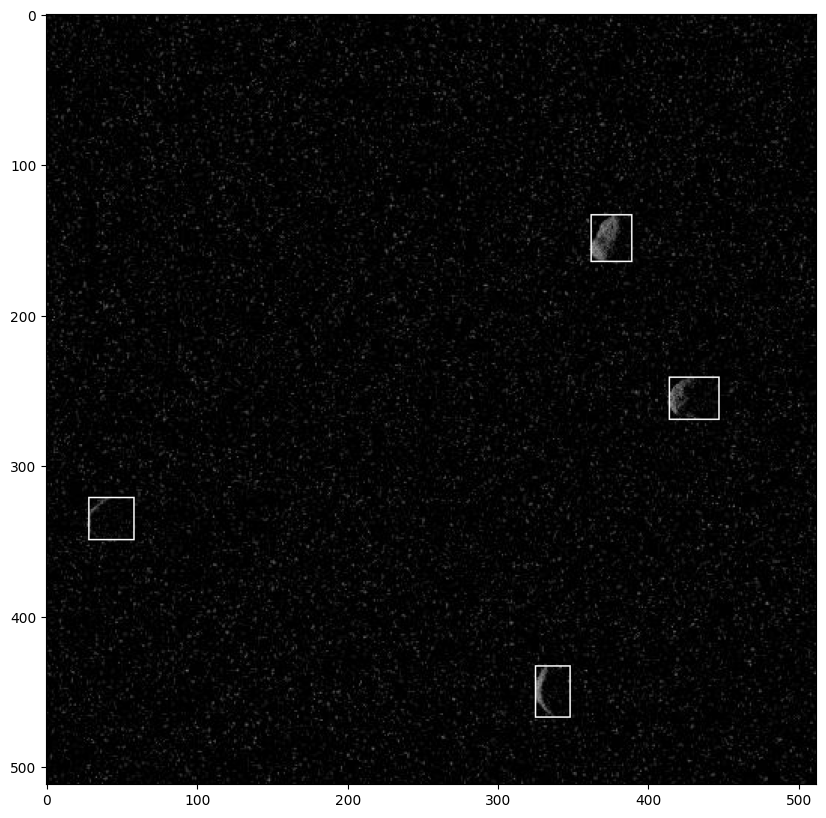

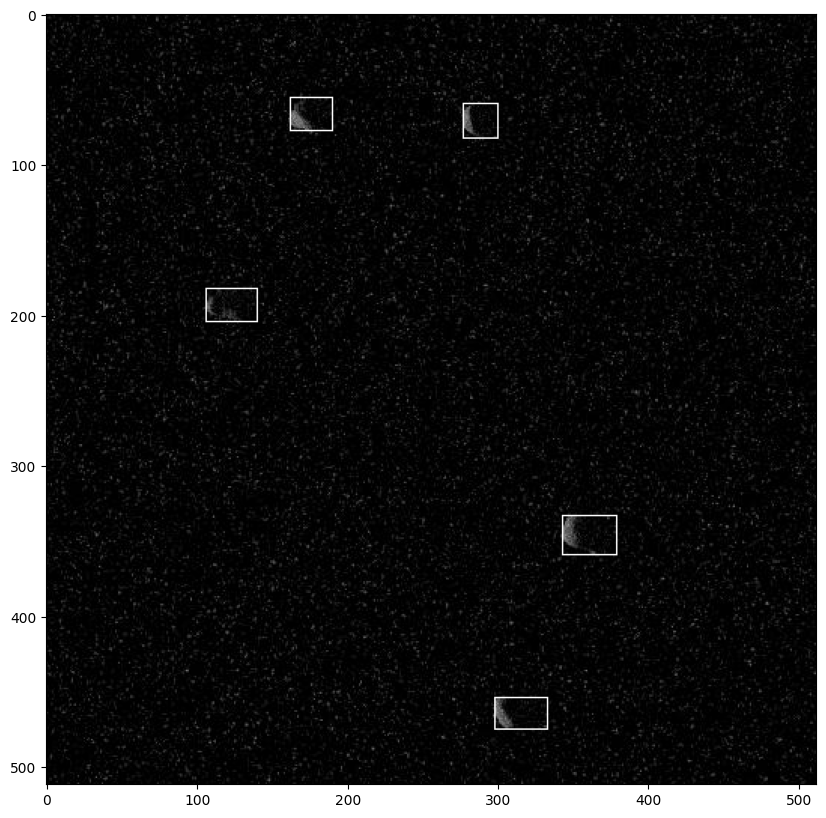

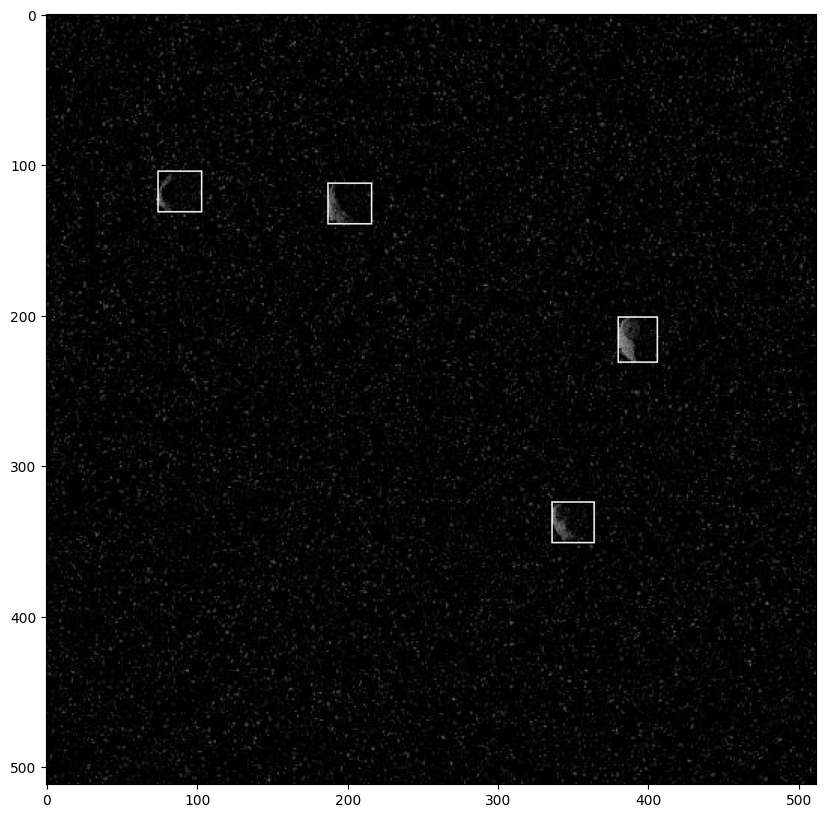

In [11]:
def show_images(images, num = 20):

    images_to_show = np.random.choice(images, num)

    for image_id in images_to_show:

        image = Image.open(os.path.join(data_path, f"train/{image_id}.jpg"))

        bboxes = literal_eval(train_df.loc[train_df['ImageID'] == image_id]['bboxes'].values[0])

        draw = ImageDraw.Draw(image)
        for bbox in bboxes:
            draw.rectangle([bbox[0], bbox[2], bbox[1], bbox[3]], width=1)

        plt.figure(figsize = (10,10))
        plt.imshow(image)
        plt.show()

show_images(train_df['ImageID'].unique(), num = 20)

In [12]:
dict_dataset = []
def get_dataset_dics():

    for index, row in train_df.iterrows():

        image = Image.open(os.path.join(data_path, f"train/{row['ImageID']}.jpg"))
        w, h = image.size

        ann_lst = []

        bboxes = literal_eval(row['bboxes'])

        for n, bbox in enumerate(bboxes):

            ann_dict = {'bbox': [bbox[0], bbox[2], bbox[1], bbox[3]],
           'bbox_mode': BoxMode.XYXY_ABS,
           'category_id': 0, #i[1]['category_id'].values[0],
           'iscrowd': 0}

            ann_lst.append(ann_dict)

        image_dict = {'annotations': ann_lst,
            'file_name': os.path.join(data_path, f"train/{row['ImageID']}.jpg"),
            'height': h,
            'image_id': row["ImageID"], #i[1]['image_category_id'].values[0],
            'width': w}

        dict_dataset.append(image_dict)

    return dict_dataset

dict_dataset = get_dataset_dics()

In [13]:
d = f"debris_train{np.random.randint(10000)}"
DatasetCatalog.register(d, lambda d=d : get_dataset_dics())
MetadataCatalog.get(d).set(thing_classes=["Debris"])
obj_metadata = MetadataCatalog.get(d)

In [14]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_DC5_3x.yaml"))
cfg.DATASETS.TRAIN = (d,)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_DC5_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 200
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

In [15]:
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/21 08:25:21 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
 

model_final_68d202.pkl: 663MB [00:25, 25.9MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[05/21 08:25:58 d2.engine.train_loop]: Starting training from iteration 0


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/local/lib/python3.10/dist-packages/torch/functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3549.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[05/21 08:26:12 d2.utils.events]:  eta: 0:01:31  iter: 19  total_loss: 1.266  loss_cls: 0.6551  loss_box_reg: 0.5471  loss_rpn_cls: 0.04341  loss_rpn_loc: 0.009699    time: 0.4816  last_time: 0.5352  data_time: 0.0187  last_data_time: 0.0227   lr: 2.3976e-05  max_mem: 3366M
[05/21 08:26:27 d2.utils.events]:  eta: 0:01:14  iter: 39  total_loss: 0.9747  loss_cls: 0.4128  loss_box_reg: 0.5871  loss_rpn_cls: 0.02901  loss_rpn_loc: 0.01016    time: 0.4697  last_time: 0.4416  data_time: 0.0133  last_data_time: 0.0157   lr: 4.8951e-05  max_mem: 3366M
[05/21 08:26:37 d2.utils.events]:  eta: 0:01:04  iter: 59  total_loss: 0.9901  loss_cls: 0.2951  loss_box_reg: 0.665  loss_rpn_cls: 0.01798  loss_rpn_loc: 0.01022    time: 0.4694  last_time: 0.4763  data_time: 0.0082  last_data_time: 0.0080   lr: 7.3926e-05  max_mem: 3366M
[05/21 08:26:46 d2.utils.events]:  eta: 0:00:55  iter: 79  total_loss: 0.9243  loss_cls: 0.2208  loss_box_reg: 0.6853  loss_rpn_cls: 0.009127  loss_rpn_loc: 0.009584    time: 0

In [16]:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [17]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
predictor = DefaultPredictor(cfg)

[05/21 08:37:57 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [18]:
test_imgs_paths = os.listdir(os.path.join(data_path, "test"))

predictions = {"ImageID":[], "bboxes":[]}

for test_img_path in tqdm(test_imgs_paths):

  img = cv2.imread(os.path.join(data_path, "test", test_img_path))
  h, w, _ = img.shape

  model_predictions = predictor(img)

  bboxes = model_predictions['instances'].pred_boxes.tensor.cpu().numpy().tolist()
  scores = model_predictions['instances'].scores.cpu().numpy().tolist()

  for n, bbox in enumerate(bboxes):

      bboxes[n] == bbox.append(scores[n])

  image_id = test_img_path.split('.')[0]

  predictions['ImageID'].append(image_id)
  predictions['bboxes'].append(bboxes)

  0%|          | 0/5000 [00:00<?, ?it/s]

In [19]:
submission = pd.DataFrame(predictions)
submission

,ImageID,bboxes
0,3400,"[[411.8998718261719, 46.82122039794922, 438.15..."
1,449,"[[381.2828063964844, 441.4308166503906, 406.62..."
2,4156,"[[144.76356506347656, 219.50836181640625, 171...."
3,1726,"[[147.1179656982422, 244.39566040039062, 172.5..."
4,4518,"[[156.82965087890625, 111.73114776611328, 183...."
...,...,...
4995,1004,"[[395.0364685058594, 296.7685241699219, 419.41..."
4996,2006,"[[366.7283630371094, 344.5545654296875, 397.96..."
4997,4550,"[[389.63372802734375, 52.04728317260742, 422.3..."
4998,4437,"[[218.70706176757812, 123.2681884765625, 247.3..."


In [20]:
submission.to_csv("submission.csv", index=True)